In [46]:
import numpy as np 
import pandas as pd
import matplotlib.pyplot as plt
import seaborn as sns
from datetime import datetime as d
from sklearn.svm import SVC
from sklearn.metrics import classification_report,confusion_matrix
from sklearn.preprocessing import LabelEncoder
import plotly.graph_objects as go
from sklearn import tree
from sklearn.decomposition import PCA
from mpl_toolkits.mplot3d import Axes3D
from sklearn.model_selection import train_test_split
from sklearn.ensemble import RandomForestClassifier
from sklearn.ensemble import GradientBoostingClassifier
import tkinter as tk
from tkinter import messagebox
from tkinter import ttk
import numpy as np
import pandas as pd
from sklearn.tree import DecisionTreeClassifier
from sklearn.model_selection import train_test_split
from sklearn import tree

In [2]:
data=pd.read_csv('healthcare_dataset.csv')
data.head()

,Name,Age,Gender,Blood Type,Medical Condition,Date of Admission,Doctor,Hospital,Insurance Provider,Billing Amount,Room Number,Admission Type,Discharge Date,Medication,Test Results
0,Bobby JacksOn,30,Male,B-,Cancer,2024-01-31,Matthew Smith,Sons and Miller,Blue Cross,18856.281306,328,Urgent,2024-02-02,Paracetamol,Normal
1,LesLie TErRy,62,Male,A+,Obesity,2019-08-20,Samantha Davies,Kim Inc,Medicare,33643.327287,265,Emergency,2019-08-26,Ibuprofen,Inconclusive
2,DaNnY sMitH,76,Female,A-,Obesity,2022-09-22,Tiffany Mitchell,Cook PLC,Aetna,27955.096079,205,Emergency,2022-10-07,Aspirin,Normal
3,andrEw waTtS,28,Female,O+,Diabetes,2020-11-18,Kevin Wells,"Hernandez Rogers and Vang,",Medicare,37909.782410,450,Elective,2020-12-18,Ibuprofen,Abnormal
4,adrIENNE bEll,43,Female,AB+,Cancer,2022-09-19,Kathleen Hanna,White-White,Aetna,14238.317814,458,Urgent,2022-10-09,Penicillin,Abnormal


In [3]:
data.head()

,Name,Age,Gender,Blood Type,Medical Condition,Date of Admission,Doctor,Hospital,Insurance Provider,Billing Amount,Room Number,Admission Type,Discharge Date,Medication,Test Results
0,Bobby JacksOn,30,Male,B-,Cancer,2024-01-31,Matthew Smith,Sons and Miller,Blue Cross,18856.281306,328,Urgent,2024-02-02,Paracetamol,Normal
1,LesLie TErRy,62,Male,A+,Obesity,2019-08-20,Samantha Davies,Kim Inc,Medicare,33643.327287,265,Emergency,2019-08-26,Ibuprofen,Inconclusive
2,DaNnY sMitH,76,Female,A-,Obesity,2022-09-22,Tiffany Mitchell,Cook PLC,Aetna,27955.096079,205,Emergency,2022-10-07,Aspirin,Normal
3,andrEw waTtS,28,Female,O+,Diabetes,2020-11-18,Kevin Wells,"Hernandez Rogers and Vang,",Medicare,37909.782410,450,Elective,2020-12-18,Ibuprofen,Abnormal
4,adrIENNE bEll,43,Female,AB+,Cancer,2022-09-19,Kathleen Hanna,White-White,Aetna,14238.317814,458,Urgent,2022-10-09,Penicillin,Abnormal


In [4]:
data.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 55500 entries, 0 to 55499
Data columns (total 15 columns):
 #   Column              Non-Null Count  Dtype  
---  ------              --------------  -----  
 0   Name                55500 non-null  object 
 1   Age                 55500 non-null  int64  
 2   Gender              55500 non-null  object 
 3   Blood Type          55500 non-null  object 
 4   Medical Condition   55500 non-null  object 
 5   Date of Admission   55500 non-null  object 
 6   Doctor              55500 non-null  object 
 7   Hospital            55500 non-null  object 
 8   Insurance Provider  55500 non-null  object 
 9   Billing Amount      55500 non-null  float64
 10  Room Number         55500 non-null  int64  
 11  Admission Type      55500 non-null  object 
 12  Discharge Date      55500 non-null  object 
 13  Medication          55500 non-null  object 
 14  Test Results        55500 non-null  object 
dtypes: float64(1), int64(2), object(12)
memory usage: 6.4

In [5]:
data.drop(columns=['Name','Room Number','Hospital'],inplace=True)

In [6]:
data.describe()

,Age,Billing Amount
count,55500.000000,55500.000000
mean,51.539459,25539.316097
std,19.602454,14211.454431
min,13.000000,-2008.492140
25%,35.000000,13241.224652
50%,52.000000,25538.069376
75%,68.000000,37820.508436
max,89.000000,52764.276736


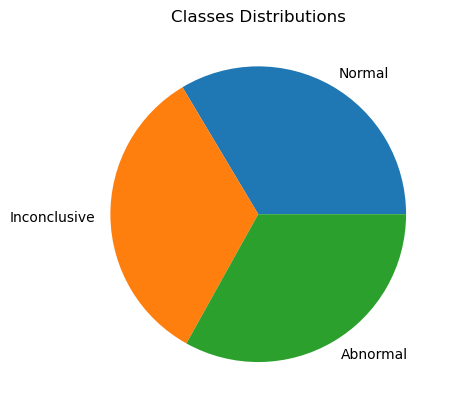

In [7]:
plt.pie(pd.DataFrame(data['Test Results']).value_counts(),labels=data['Test Results'].unique())
plt.title("Classes Distributions")
plt.show()

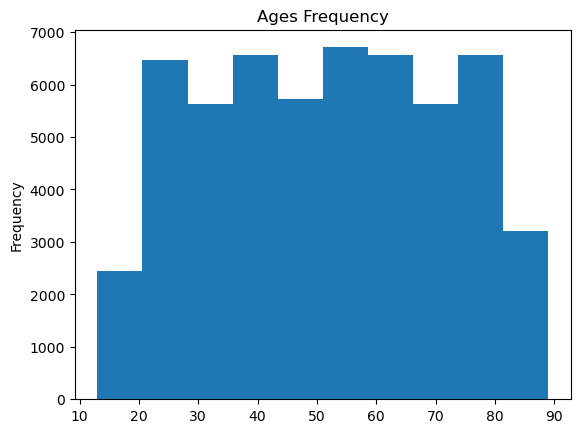

In [8]:
plt.title("Ages Frequency")
data['Age'].plot.hist()
plt.show()

In [9]:
data.describe()

,Age,Billing Amount
count,55500.000000,55500.000000
mean,51.539459,25539.316097
std,19.602454,14211.454431
min,13.000000,-2008.492140
25%,35.000000,13241.224652
50%,52.000000,25538.069376
75%,68.000000,37820.508436
max,89.000000,52764.276736


In [10]:
grouped = data.groupby(["Test Results", "Blood Type"]).size().reset_index(name='count')


In [11]:
A_p = grouped[grouped["Blood Type"] == "A+"]
A_m = grouped[grouped["Blood Type"] == "A-"]
AB_p = grouped[grouped["Blood Type"] == "AB+"]
AB_m = grouped[grouped["Blood Type"] == "AB-"]
B_p = grouped[grouped["Blood Type"] == "B+"]
B_m = grouped[grouped["Blood Type"] == "B-"]
O_p = grouped[grouped["Blood Type"] == "O+"]
O_m = grouped[grouped["Blood Type"] == "O-"]


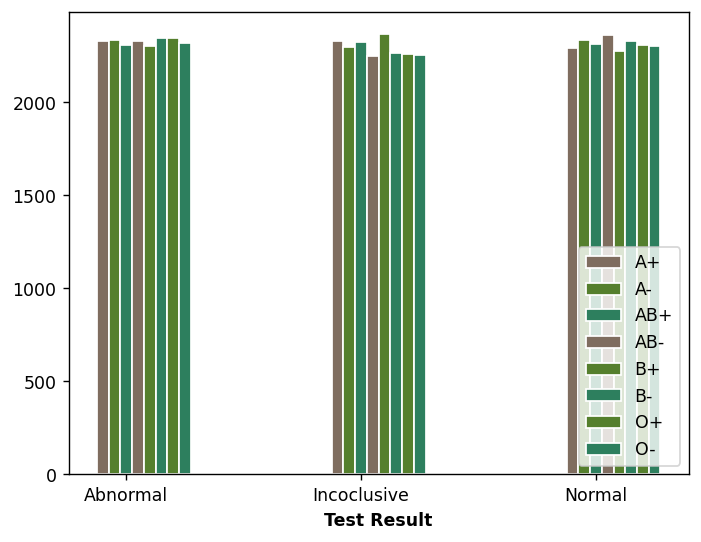

In [12]:
barWidth=0.05
r = np.arange(len(A_p))
r2 = r + barWidth
r3 = r2 + barWidth
r4 = r3 + barWidth
r5 = r4 + barWidth
r6 = r5 + barWidth
r7 = r6 + barWidth
r8 = r7 + barWidth

fig, ax = plt.subplots(dpi=125)
ax.bar(r, A_p['count'].values, color='#7f6d5f', width=barWidth, edgecolor='white', label='A+')
ax.bar(r2, A_m['count'].values, color='#557f2d', width=barWidth, edgecolor='white', label='A-')
ax.bar(r3, AB_p['count'].values, color='#2d7f5e', width=barWidth, edgecolor='white', label='AB+')
ax.bar(r4, AB_m['count'].values, color='#7f6d5f', width=barWidth, edgecolor='white', label='AB-')
ax.bar(r5, B_p['count'].values, color='#557f2d', width=barWidth, edgecolor='white', label='B+')
ax.bar(r6, B_m['count'].values, color='#2d7f5e', width=barWidth, edgecolor='white', label='B-')
ax.bar(r7, O_p['count'].values, color='#557f2d', width=barWidth, edgecolor='white', label='O+')
ax.bar(r8, O_m['count'].values, color='#2d7f5e', width=barWidth, edgecolor='white', label='O-')
ax.set_xlabel('Test Result', fontweight='bold')
ax.set_xticks(r2+barWidth,['Abnormal','Incoclusive','Normal'])
#ax.set_xticklabels()
ax.legend(loc='lower right')
plt.show()

In [13]:
data

,Age,Gender,Blood Type,Medical Condition,Date of Admission,Doctor,Insurance Provider,Billing Amount,Admission Type,Discharge Date,Medication,Test Results
0,30,Male,B-,Cancer,2024-01-31,Matthew Smith,Blue Cross,18856.281306,Urgent,2024-02-02,Paracetamol,Normal
1,62,Male,A+,Obesity,2019-08-20,Samantha Davies,Medicare,33643.327287,Emergency,2019-08-26,Ibuprofen,Inconclusive
2,76,Female,A-,Obesity,2022-09-22,Tiffany Mitchell,Aetna,27955.096079,Emergency,2022-10-07,Aspirin,Normal
3,28,Female,O+,Diabetes,2020-11-18,Kevin Wells,Medicare,37909.782410,Elective,2020-12-18,Ibuprofen,Abnormal
4,43,Female,AB+,Cancer,2022-09-19,Kathleen Hanna,Aetna,14238.317814,Urgent,2022-10-09,Penicillin,Abnormal
...,...,...,...,...,...,...,...,...,...,...,...,...
55495,42,Female,O+,Asthma,2020-08-16,Joshua Jarvis,Blue Cross,2650.714952,Elective,2020-09-15,Penicillin,Abnormal
55496,61,Female,AB-,Obesity,2020-01-23,Taylor Sullivan,Cigna,31457.797307,Elective,2020-02-01,Aspirin,Normal
55497,38,Female,B+,Hypertension,2020-07-13,Joe Jacobs DVM,UnitedHealthcare,27620.764717,Urgent,2020-08-10,Ibuprofen,Abnormal
55498,43,Male,O-,Arthritis,2019-05-25,Kimberly Curry,Medicare,32451.092358,Elective,2019-05-31,Ibuprofen,Abnormal


In [14]:
data_cpy=data.copy()
data_cpy['Date of Admission']=pd.to_datetime(data_cpy['Date of Admission'])
data_cpy['Discharge Date']=pd.to_datetime(data_cpy['Discharge Date'])

In [15]:
data_cpy.info()


<class 'pandas.core.frame.DataFrame'>
RangeIndex: 55500 entries, 0 to 55499
Data columns (total 12 columns):
 #   Column              Non-Null Count  Dtype         
---  ------              --------------  -----         
 0   Age                 55500 non-null  int64         
 1   Gender              55500 non-null  object        
 2   Blood Type          55500 non-null  object        
 3   Medical Condition   55500 non-null  object        
 4   Date of Admission   55500 non-null  datetime64[ns]
 5   Doctor              55500 non-null  object        
 6   Insurance Provider  55500 non-null  object        
 7   Billing Amount      55500 non-null  float64       
 8   Admission Type      55500 non-null  object        
 9   Discharge Date      55500 non-null  datetime64[ns]
 10  Medication          55500 non-null  object        
 11  Test Results        55500 non-null  object        
dtypes: datetime64[ns](2), float64(1), int64(1), object(8)
memory usage: 5.1+ MB


In [16]:
data_cpy.rename(columns={'Date of Admission':'Days since Admission','Discharge Date':'Days since Discharge'},inplace=True)

In [17]:
data_cpy


,Age,Gender,Blood Type,Medical Condition,Days since Admission,Doctor,Insurance Provider,Billing Amount,Admission Type,Days since Discharge,Medication,Test Results
0,30,Male,B-,Cancer,2024-01-31,Matthew Smith,Blue Cross,18856.281306,Urgent,2024-02-02,Paracetamol,Normal
1,62,Male,A+,Obesity,2019-08-20,Samantha Davies,Medicare,33643.327287,Emergency,2019-08-26,Ibuprofen,Inconclusive
2,76,Female,A-,Obesity,2022-09-22,Tiffany Mitchell,Aetna,27955.096079,Emergency,2022-10-07,Aspirin,Normal
3,28,Female,O+,Diabetes,2020-11-18,Kevin Wells,Medicare,37909.782410,Elective,2020-12-18,Ibuprofen,Abnormal
4,43,Female,AB+,Cancer,2022-09-19,Kathleen Hanna,Aetna,14238.317814,Urgent,2022-10-09,Penicillin,Abnormal
...,...,...,...,...,...,...,...,...,...,...,...,...
55495,42,Female,O+,Asthma,2020-08-16,Joshua Jarvis,Blue Cross,2650.714952,Elective,2020-09-15,Penicillin,Abnormal
55496,61,Female,AB-,Obesity,2020-01-23,Taylor Sullivan,Cigna,31457.797307,Elective,2020-02-01,Aspirin,Normal
55497,38,Female,B+,Hypertension,2020-07-13,Joe Jacobs DVM,UnitedHealthcare,27620.764717,Urgent,2020-08-10,Ibuprofen,Abnormal
55498,43,Male,O-,Arthritis,2019-05-25,Kimberly Curry,Medicare,32451.092358,Elective,2019-05-31,Ibuprofen,Abnormal


In [18]:
data_cpy['Days since Admission']=(d.now()-data_cpy['Days since Admission']).dt.days
data_cpy['Days since Dischrage']=(d.now()-data_cpy['Days since Discharge']).dt.days

In [19]:
for col in data_cpy.columns:
    if (data_cpy[col].dtype=='datetime64[ns]'):
        data_cpy.drop(columns=[f'{col}'],inplace=True)
        break;

In [20]:
data_cpy.drop(columns=['Doctor','Insurance Provider'],inplace=True)

In [21]:
le=LabelEncoder()


In [22]:
for col in data_cpy.columns:
    if(data_cpy[col].dtype=='object'):
        data_cpy[col]=le.fit_transform(data_cpy[col])

In [23]:
data_3d=data_cpy.copy()
pca=PCA(n_components=3)
data_3d.drop(columns=['Test Results'],inplace=True)
data_3d=pca.fit_transform(data_3d)

In [24]:
data_3d=pd.DataFrame(data_3d,columns=['X1','X2','X3'])


In [25]:
data_3d['Test Results']=data_cpy['Test Results']


In [26]:
data_3d.shape

(55500, 4)

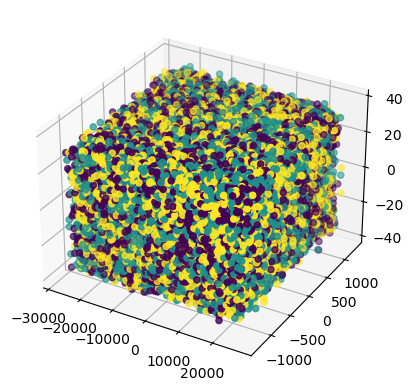

In [27]:
fig = plt.figure()
ax = fig.add_subplot(111, projection='3d')
ax.scatter(data_3d['X1'], data_3d['X2'], data_3d['X3'],c=data_3d['Test Results'])
plt.show()

In [28]:
data2=data_cpy.copy()
data2.drop(columns=['Billing Amount','Days since Admission','Days since Dischrage'],inplace=True)

In [29]:
pca=PCA(n_components=3)
data2_3d=pca.fit_transform(data2.drop(columns=['Test Results']))

In [30]:
data2_3d.shape


(55500, 3)

In [31]:
data2_3d=pd.DataFrame(data2_3d,columns=['X1','X2','X3'])


In [32]:
data2_3d['Test Results']=data2['Test Results']


In [33]:
fig = go.Figure(data=[go.Scatter3d(
    x=data2_3d['X1'],
    y=data2_3d['X2'],
    z=data2_3d['X3'],
    mode='markers',
    marker=dict(
        size=8,
        color=data2_3d['Test Results'],  # Use z-values for color
        colorscale='Viridis',  # Set the color scale
        opacity=0.8
    )
)])


In [34]:
fig.update_layout(
    title="3D Scatter Plot",
    scene=dict(
        xaxis_title="X Axis",
        yaxis_title="Y Axis",
        zaxis_title="Z Axis"
    )
)

In [35]:
data2[data2['Test Results']==0]=1


In [36]:
data2.head()
data2.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 55500 entries, 0 to 55499
Data columns (total 7 columns):
 #   Column             Non-Null Count  Dtype
---  ------             --------------  -----
 0   Age                55500 non-null  int64
 1   Gender             55500 non-null  int32
 2   Blood Type         55500 non-null  int32
 3   Medical Condition  55500 non-null  int32
 4   Admission Type     55500 non-null  int32
 5   Medication         55500 non-null  int32
 6   Test Results       55500 non-null  int32
dtypes: int32(6), int64(1)
memory usage: 1.7 MB


In [37]:
pca=PCA(n_components=3)
data2_3d=pca.fit_transform(data2.drop(columns=['Test Results']))

In [38]:
data2_3d=pd.DataFrame(data2_3d,columns=['X1','X2','X3'])
data2_3d['Test Results']=data2['Test Results']

In [39]:
fig = go.Figure(data=[go.Scatter3d(
    x=data2_3d['X1'],
    y=data2_3d['X2'],
    z=data2_3d['X3'],
    mode='markers',
    marker=dict(
        size=8,
        color=data2_3d['Test Results'],  # Use z-values for color
        colorscale='Viridis',  # Set the color scale
        opacity=0.8
    )
)])

In [40]:
fig.update_layout(
    title="3D Scatter Plot",
    scene=dict(
        xaxis_title="X Axis",
        yaxis_title="Y Axis",
        zaxis_title="Z Axis"
    )
)

In [41]:
X,y=data2.drop(columns=['Test Results']),data2['Test Results']
X_train,X_test,y_train,y_test=train_test_split(X,y,test_size=0.33,random_state=42)

              precision    recall  f1-score   support

           1       0.95      1.00      0.97     24806
           2       0.99      0.89      0.94     12379

    accuracy                           0.96     37185
   macro avg       0.97      0.95      0.96     37185
weighted avg       0.96      0.96      0.96     37185



<Axes: >

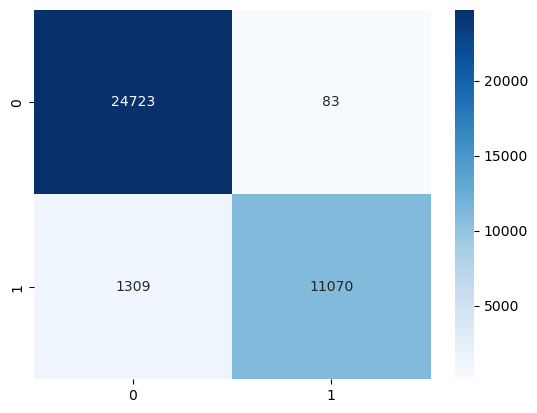

In [42]:
DT=tree.DecisionTreeClassifier()
DT.fit(X_train,y_train)
y_train_predict=DT.predict(X_train)
print(classification_report(y_train,y_train_predict))
cm = confusion_matrix(y_train, y_train_predict)
sns.heatmap(cm, cmap='Blues', annot=True, fmt='.0f')



In [49]:
# ========= واجهة المستخدم =========

window = tk.Tk()
window.title("نظام التنبؤ بنتائج التحاليل")
window.geometry("400x600")

# الخيارات
options = {
    'Gender': ['Male', 'Female'],
    'Blood Type': ['A+', 'A-', 'B+', 'B-', 'O+', 'O-', 'AB+', 'AB-'],
    'Medical Condition': ['Cancer', 'Obesity', 'Diabetes', 'Asthma', 'Hypertension', 'Arthritis', 'Heart Disease'],
    'Admission Type': ['Urgent', 'Emergency', 'Elective'],
    'Medication': ['Paracetamol', 'Ibuprofen', 'Aspirin', 'Penicillin', 'Lipitor', 'Albuterol', 'Atorvastatin'],
    'Test Results': ['Normal', 'Inconclusive', 'Abnormal']
}

# إنشاء الواجهة
tk.Label(window, text="العمر:").pack()
age_entry = tk.Entry(window)
age_entry.pack()

tk.Label(window, text="النوع:").pack()
gender_box = ttk.Combobox(window, values=options['Gender'])
gender_box.pack()

tk.Label(window, text="فصيلة الدم:").pack()
blood_box = ttk.Combobox(window, values=options['Blood Type'])
blood_box.pack()

tk.Label(window, text="الحالة الطبية:").pack()
condition_box = ttk.Combobox(window, values=options['Medical Condition'])
condition_box.pack()

tk.Label(window, text="نوع الدخول:").pack()
admission_box = ttk.Combobox(window, values=options['Admission Type'])
admission_box.pack()

tk.Label(window, text="نوع الدواء:").pack()
medication_box = ttk.Combobox(window, values=options['Medication'])
medication_box.pack()

# قواميس لتحويل الكودات إلى الأسماء
reverse_options = {
    'Gender': {0: 'Male', 1: 'Female'},
    'Blood Type': {0: 'A+', 1: 'A-', 2: 'B+', 3: 'B-', 4: 'O+', 5: 'O-', 6: 'AB+', 7: 'AB-'},
    'Medical Condition': {0: 'Cancer', 1: 'Obesity', 2: 'Diabetes', 3: 'Asthma', 4: 'Hypertension', 5: 'Arthritis', 6: 'Heart Disease'},
    'Admission Type': {0: 'Urgent', 1: 'Emergency', 2: 'Elective'},
    'Medication': {0: 'Paracetamol', 1: 'Ibuprofen', 2: 'Aspirin', 3: 'Penicillin', 4: 'Lipitor', 5: 'Albuterol', 6: 'Atorvastatin'},
    'Test Results': {0: 'Normal', 1: 'Inconclusive', 2: 'Abnormal'}
}

# ========= الدالة الخاصة بالتنبؤ =========
ٍٍ
# بعد تدريب النموذج، نحفظ أسماء الأعمدة (الميزات)
feature_names = X.columns

# في الدالة الخاصة بالتنبؤ، نمرر البيانات بشكل صحيح مع الأسماء
def predict():
    try:
        # جلب القيم
        age = int(age_entry.get())
        gender = 0 if gender_box.get() == "Male" else 1
        blood_dict = {blood: idx for idx, blood in enumerate(options['Blood Type'])}
        blood = blood_dict[blood_box.get()]
        
        condition_dict = {condition: idx for idx, condition in enumerate(options['Medical Condition'])}
        condition = condition_dict[condition_box.get()]
        
        admission_dict = {admission: idx for idx, admission in enumerate(options['Admission Type'])}
        admission = admission_dict[admission_box.get()]
        
        medication_dict = {medication: idx for idx, medication in enumerate(options['Medication'])}
        medication = medication_dict[medication_box.get()]

        # تجهيز البيانات مع أسماء الأعمدة
        input_data = np.array([[age, gender, blood, condition, admission, medication]])

        # التأكد من أن لدينا أسماء الأعمدة
        input_data_df = pd.DataFrame(input_data, columns=feature_names)

        # التنبؤ
        prediction = DT.predict(input_data_df)

        # تحويل الكود الرقمي إلى الاسم باستخدام القواميس
        result_name = reverse_options['Test Results'][prediction[0]]

        messagebox.showinfo("النتيجة", f"النتيجة المتوقعة: {result_name}")

    except Exception as e:
        messagebox.showerror("خطأ", f"حدث خطأ: {e}")


tk.Button(window, text="تنبأ بالنتيجة", command=predict).pack(pady=20)

window.mainloop()